# MSU CMC - spatially aware style transfer

* You only need to send your solution, without accompanying files, in uncompressed form
* Rename your solution in the format [name]\_[surname].ipynb, for example Ivan_Ivanov.ipynb

In this work, you will modify [the baseline optimization-based style transfer method](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf), with the following [implementation](https://github.com/leongatys/PytorchNeuralStyleTransfer/blob/master/NeuralStyleTransfer.ipynb). It makes uniform stylization of the whole content image with the whole style image. However, real artists apply different style to semantically different objects, such as people, buildings, cars and the background. You need to make spatially aware style transfer using several approaches, so that each part of content is stylized with some part of style (style parts may intersect). If you have any questions, write in telegram to @VictorKitov, I will answer to common chat.

The content image is split into parts based on semantic segmentation, that works on demo content images (`Images/Contents`). The style image is split into parts using [superpixels](https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_segmentations.html) - you need to try several approaches and finetune hyperparameters for each approach. Afterwards the matching procedure takes place. Similar parts of style are matched to similar parts of content (many to one mapping). You need to select proximity criterion yourself, that works better - this may be closeness in RGB color distributuion or closeness in distribution of activations at some intermediate layer of the VGG neural network (measures closeness in patterns rather than in colors only). Alternatively this may be closeness in color distribution after both images were converted to grayscale (since originally content and style may consist of very different colors). Сloseness may be estimated by comparing the vectors of means and standard deviations for content and style part by Euclidean or cosine distance. 

Semantically aware style transfer can generate stylizations where different parts of content vary in style too much so an *averaging hyperparameter* is required: if 0, different parts of content are stylized with different parts of style. The closer is this hyperparameter to 1, the more uniform stylization becomes (more mixing of styles from all available superpixels at the matching stage). If 1 exaclty, the method reduces to uniform baseline style transfer.

Reporting your solution

The solution consists of several approaches that you try. Each approach starts from H1 heading "Method 1", "Method2", etc. Each method starts from textual description in markdown of your approach (pseudocode with latex preferred for clarity), naming which segmentation and superpixel algorithm with which parameters you choose, how you estimate closeness between segments and superpixels.
Then comes the code with its output: for _every content image in `Images/Contents` and every style image from `Images/Styles` (16 pairs)_ you show content  and its segmentation mask (1st row), style image and its superpixel mask (2nd row, matched parts of content and style should have the same color) and baseline stylization and semantically aware stylization side-by-side (3rd row). Each row extends to full jupyter notebook width for better visualization.

You solution is judged accorind to the following criteria
* Does it coinside with solution of some other student? If yes, both students get 0 points for the solution.
* How many approaches you test (+2 points for every method, 6 points max. Methods may differ in superpixel algorithm, preprocessing (color or grayscale) or closeness metric. Using the same method with different hyperparameters does not count - you should adjust hyperparameters for each method and report results with beset hyperparameters only.)
* Visual quality of your solutions compared to baseline (how well you selected the hyperparameters) - 4 points.
* Implement *averaging hyperparameter* for some method (2 points). You make a heading "Averaging", provide a markdown description of the averaging approach, the code and visualize content, style (one pair is enough) and 4 stylizations for averaging parameter 0, 0.33, 0.66, 1.



# Overview:

This notebook contains rewritten code to make training of classic model within 2 lines of code

In [44]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [45]:
%pylab inline
import time
import os
import numpy as np
image_dir = os.getcwd() + '/Images/'
model_dir = os.getcwd() + '/Models/'
content_dir = os.getcwd() + '/Images/Contents'
style_dir = os.getcwd() + '/Images/Styles'


import torch
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F
from torch import optim

import torchvision
from torchvision import transforms
from torchvision import models
import matplotlib.pyplot as plt

from PIL import Image
from collections import OrderedDict

Populating the interactive namespace from numpy and matplotlib


c:\users\fastaki\pycharmprojects\pythonproject\venv\lib\site-packages\IPython\core\magics\pylab.py:159: UserWarning: pylab import has clobbered these variables: ['plt', 'time']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


In [46]:
from argparse import Namespace
from copy import deepcopy

import gc
from time import time

In [47]:
import scipy

In [48]:
from torchvision.utils import draw_segmentation_masks
from torchvision.transforms.functional import InterpolationMode

from torch.nn.utils import clip_grad_norm_, clip_grad_value_

In [49]:
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from skimage.filters import sobel

from skimage.color import rgb2gray
from skimage import io as skio

In [50]:
torch.cuda.is_available()

True

In [51]:
resize_size = 512

## Defining standart version of VGG

In [52]:
class VGG(nn.Module):
    def __init__(self, pool='max'):
        super(VGG, self).__init__()
        #vgg modules
        self.conv1_1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv1_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.conv2_1 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.conv3_1 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_4 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv4_1 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_4 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        if pool == 'max':
            self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)
        elif pool == 'avg':
            self.pool1 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool2 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool3 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool4 = nn.AvgPool2d(kernel_size=2, stride=2)
            self.pool5 = nn.AvgPool2d(kernel_size=2, stride=2)
            
    def forward(self, x, out_keys):
        out = {}
        out['r11'] = F.relu(self.conv1_1(x))
        out['r12'] = F.relu(self.conv1_2(out['r11']))
        out['p1'] = self.pool1(out['r12'])
        out['r21'] = F.relu(self.conv2_1(out['p1']))
        out['r22'] = F.relu(self.conv2_2(out['r21']))
        out['p2'] = self.pool2(out['r22'])
        out['r31'] = F.relu(self.conv3_1(out['p2']))
        out['r32'] = F.relu(self.conv3_2(out['r31']))
        out['r33'] = F.relu(self.conv3_3(out['r32']))
        out['r34'] = F.relu(self.conv3_4(out['r33']))
        out['p3'] = self.pool3(out['r34'])
        out['r41'] = F.relu(self.conv4_1(out['p3']))
        out['r42'] = F.relu(self.conv4_2(out['r41']))
        out['r43'] = F.relu(self.conv4_3(out['r42']))
        out['r44'] = F.relu(self.conv4_4(out['r43']))
        out['p4'] = self.pool4(out['r44'])
        out['r51'] = F.relu(self.conv5_1(out['p4']))
        out['r52'] = F.relu(self.conv5_2(out['r51']))
        out['r53'] = F.relu(self.conv5_3(out['r52']))
        out['r54'] = F.relu(self.conv5_4(out['r53']))
        out['p5'] = self.pool5(out['r54'])
        return [out[key] for key in out_keys]
    
def create_vgg():
    
    vgg = VGG()
    vgg.load_state_dict(torch.load(model_dir + 'vgg_conv.pth'))
    
    for param in vgg.parameters():
        param.requires_grad = False
    
    if torch.cuda.is_available():
        vgg.cuda()
        
    return vgg


In [53]:
class GramMatrix(nn.Module):
    def forward(self, input):
        b,c,h,w = input.size()
        F = input.view(b, c, h*w)
        G = torch.bmm(F, F.transpose(1,2)) 
        G.div_(h*w)
        return G

class GramMSELoss(nn.Module):
    def forward(self, input, target):
        out = nn.MSELoss()(GramMatrix()(input), target)
        return(out)

## Defining Pre/Post-processing

In [54]:
def preprocessing(img, img_size = resize_size):
    
    prep = transforms.Compose([transforms.Resize(img_size),
                           transforms.ToTensor(),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to BGR
                           transforms.Normalize(mean=[0.40760392, 0.45795686, 0.48501961], #subtract imagenet mean
                                                std = [0.229, 0.224, 0.225]),
                                                #std = [1, 1, 1]),
                           transforms.Lambda(lambda x: x.mul_(255)),
                          ])
    
    return prep(img)

def postprocessing(img):
    
    postpa = transforms.Compose([transforms.Lambda(lambda x: x.mul_(1./255)),
                           transforms.Normalize(mean=[-0.40760392 / 0.229, -0.45795686 / 0.224, -0.48501961 / 0.225], #add imagenet mean
                                                #std=[1,1,1]),
                                                std = [1 / 0.229, 1 / 0.224, 1 / 0.225]),
                           transforms.Lambda(lambda x: x[torch.LongTensor([2,1,0])]), #turn to RGB
                           ])
    postpb = transforms.Compose([transforms.ToPILImage()])
    
    t = postpa(img)
    t[t>1] = 1    
    t[t<0] = 0
    img = postpb(t)
    return img

## Download img's

In [55]:
def load_img(name, directory):
    
    """
    loads image from directory. name - filename of that image in directory
    """
    
    if directory[-1] == "/":
        cdir = deepcopy(directory[:-1])
    else:
        cdir = deepcopy(directory)
        
    if name[0] == "/":
        cname = deepcopy(name[1:])
    else:
        cname = deepcopy(name)
        
    fname = cdir + "/" + cname
    
    return Image.open(fname)

def prepare_img(img):
    
    """
    preprocessing of image and moving her to cuda if possible
    """
    
    img_torch = preprocessing(img)
    
    if torch.cuda.is_available():
        img_torch = Variable(img_torch.unsqueeze(0).cuda())
    else:
        img_torch = Variable(img_torch.unsqueeze(0))
    return img_torch

## Defining loss functions/layers

In [56]:
def initialisation(vgg_nn, style, content):
    
    style_params = Namespace(loss_layers = None, loss_fns = None, weights = None, targets = None)
    content_params = Namespace(loss_layers = None, loss_fns = None, weights = None, targets = None)
    
    style_params.loss_layers = ['r11','r21','r31','r41', 'r51'] 
    content_params.loss_layers = ['r42']
    
    style_params.loss_fns = [GramMSELoss()] * len(style_params.loss_layers)
    content_params.loss_fns = [nn.MSELoss()] * len(content_params.loss_layers)
    
    if torch.cuda.is_available():
        
        style_params.loss_fns = [fn.cuda() for fn in style_params.loss_fns]
        content_params.loss_fns = [fn.cuda() for fn in content_params.loss_fns]
        
    style_params.weights = [1e+3/n**2 for n in [64,128,256,512,512]]
    content_params.weights = [1e+0]
    
    style_params.targets = [GramMatrix()(A).detach() for A in vgg_nn(style, style_params.loss_layers)]
    content_params.targets = [A.detach() for A in vgg_nn(content, content_params.loss_layers)]
    
    return style_params, content_params

## Train neural network

In [57]:
def style_transfer(style_nm, content_nm, max_iter = 500, show_iter = 50, silent = True):
    
    content_dir = os.getcwd() + '/Images/Contents'
    style_dir = os.getcwd() + '/Images/Styles'
    
    # loading image
    style_img = load_img(style_nm, style_dir)
    content_img = load_img(content_nm, content_dir)
    
    #transforming it to 512 x H size, generating target
    style_prep = prepare_img(style_img)
    content_prep = prepare_img(content_img)
    opt_img = Variable(content_prep.data.clone(), requires_grad = True)
    
    #print("Style shape:", style_prep.shape)
    #print("Content shape:", content_prep.shape)
    
    #creating NN
    vgg = create_vgg()
    
    
    style_params, content_params = initialisation(vgg, style_prep, content_prep)
    loss_layers = style_params.loss_layers + content_params.loss_layers
    
    optimizer = optim.LBFGS([opt_img])
    n_iter = 0
    
    while n_iter <= max_iter:
        
        def mainloop():
            
            nonlocal n_iter
        
            optimizer.zero_grad()
            output = vgg(opt_img, loss_layers)
            


            style_part, content_part = output[:5], output[5:]

            style_loss = []
            for i, layer in enumerate(style_part):

                
                style_loss.append(style_params.weights[i] * style_params.loss_fns[i](layer, style_params.targets[i]))

            content_loss = []
            for i, layer in enumerate(content_part):
                content_loss.append(content_params.weights[i] * content_params.loss_fns[i](layer, content_params.targets[i]))
            loss = style_loss[0]

            for sl in style_loss[1:]:
                loss += sl

            for cl in content_loss:
                loss += cl

            loss.backward()
            n_iter += 1
            
            if not silent:
                if n_iter % show_iter == 0:
                    print('Iteration: %d, loss: %f'%(n_iter, loss.item()))
                    plt.imshow(postprocessing(opt_img.data[0].cpu().squeeze()))
                    plt.show()
                
            return loss
        
        optimizer.step(mainloop)
    
    out_img = postprocessing(opt_img.data[0].cpu().squeeze())
    if not silent:
        plt.imshow(out_img)
        plt.gcf().set_size_inches(10,10)
    
    del vgg
    del style_params
    del content_params
    del loss_layers
    del optimizer
    del style_prep
    del content_prep
    
    if torch.cuda.is_available():
        gc.collect()
        torch.cuda.empty_cache()
    else:
        gc.collect()
    
    return out_img

## Adding Segmentation network

In [58]:
def get_activations(network, guides, layers):
    
    probe_image = torch.zeros((1, 3, ) + guides.shape[2:])
    probe_image += 1e+2 * torch.randn(*probe_image.shape)
    
    if torch.cuda.is_available():
        probe_image = probe_image.cuda()
        
    activations = network(probe_image, layers)
    
    results = []
    
    for i in range(layers.__len__()):
        
        act = activations[i]
        sf = list(np.array(act.shape).astype(int))
        sf[1] = guides.shape[1]

        arr = transforms.functional.resize(guides, size = sf[2:], interpolation=InterpolationMode.NEAREST)

    
        results.append(arr.squeeze())
        
    return results

In [59]:
def get_guides_rework(content_prep, content_mask, style_prep, style_mask, averaging = 0.0):
    
    if False:
        print(content_prep.shape)
        print(content_mask.shape)
        print(style_prep.shape)
        print(style_mask.shape)
    
    content_guides = []
    content_locs = []
    content_avgs = []
    content_stds = []
    
    for val in content_mask.unique():
        cg = (content_mask == val)
        
        if torch.sum(cg) < 1e+4:
            content_guides[0] += cg
            continue
        
        content_guides.append(cg.to(torch.float))
        
        mn = []
        st = []
        for i in range(3):
            mn.append(torch.mean(content_prep[i, :, :][cg[:, :]]))
            st.append(torch.std(content_prep[i, :, :][cg[:, :]]))
            
        content_avgs.append(mn)
        content_stds.append(st)
            

    style_avgs = []
    style_stds = []
    style_locations = []
    style_masks = []
    
    style_vals = []
    
    for val in style_mask.unique():
        
        style_vals.append(val)
        
        sg = (style_mask == val)
        style_masks.append(sg.to(torch.float))
        
        mn = []
        st = []
        for i in range(3):
            mn.append(torch.mean(style_prep[i, :, :][sg[:, :]]))
            st.append(torch.std(style_prep[i, :, :][sg[:, :]]))
            
        style_avgs.append(mn)
        style_stds.append(st)
        
        dotx, doty = torch.where(style_mask == val)
        dotx = dotx.to(torch.float)
        doty = doty.to(torch.float)
        
        style_locations.append([torch.mean(dotx), torch.mean(doty)])
     
    # переведем статистики в тензоры для более удобной работы
    style_locs = torch.Tensor(style_locations)
    content_avgs = torch.Tensor(content_avgs)
    content_stds = torch.Tensor(content_stds)
    style_avgs = torch.Tensor(style_avgs)
    style_stds = torch.Tensor(style_stds)
    style_vals = torch.Tensor(style_vals)
    
    # оценим число необходимых кусочков стилевого изображения
    n_patches = len(style_locs) / len(content_avgs)
    
    # Матрицы попарных расстояний
    locs_distances = torch.cdist(style_locs[None, :, :], style_locs[None, :, :])[0]
    color_means = torch.cdist(content_avgs[None, :, :], style_avgs[None, :, :])[0]
    color_stds = torch.cdist(content_stds[None, :, :], style_stds[None, :, :])[0]
    
    #print(locs_distances.shape, color_means.shape, color_stds.shape)
    
    # Нормализация всех 3
    color_means /= color_means.sum(dim = 1)[:, None]
    color_stds /= color_stds.sum(dim = 1)[:, None]
    locs_distances /= locs_distances.sum(dim = 1)[:, None]
    
    """
    Идея: матчим первый по сумме means и stds.
    Остальные - по means + stds + позиционка относительно ближайшего
    """
    color_avgs = color_means + color_stds
    
    only_avgs = True
    
    used_patches = set()

    if only_avgs:
        
        K = [0] * len(color_avgs)
        
        used_guides = []
        
        for i in range(len(color_avgs)):
            used_guides.append([])
        priority = torch.argsort(color_avgs, dim = 1)
        
        n_universal = min(int(priority.shape[1] * averaging), priority.shape[1])
        
        
        for i in range(n_universal):
            
            for j in range(used_guides.__len__()):
                
                used_guides[j].append(int(priority[j][i]))
                used_patches.add(int(priority[j][i]))
            
                K[j] += 1
            
        while len(used_patches) < len(locs_distances):
            
            for j in range(used_guides.__len__()):
                
                while int(priority[j][K[j]]) in used_patches:
                    K[j] += 1
                    
                    if K[j] == len(locs_distances):
                        break
                        
                if K[j] != len(locs_distances):
                    used_guides[j].append(int(priority[j][K[j]]))
                    used_patches.add(int(priority[j][K[j]]))
                    K[j] += 1
                    
        style_guides = []
        
        for patches in used_guides:
            
            sub = style_masks[patches[0]].clone()
            
            for pos in patches[1:]:
                
                sub += style_masks[pos]
            
            style_guides.append(sub)
            
        return content_guides, style_guides
    else:
        
        #WIP
        return
        
    
    #print(style_vals[torch.argsort(color_avgs, dim = 1)[:, :n_patches]])

def segmentation_model4(content_img, content_nm, model_name = "deeplabv3"):
    
    if model_name == "deeplabv3":
        model = models.segmentation.deeplabv3_resnet101(pretrained=1).eval()
    elif model_name == "resnet":
        model = torchvision.models.segmentation.fcn_resnet101(pretrained = 1).eval()

    var = Variable(content_img.cpu())
    
    result = model(var)['out']
    
    del model
    del var
    
    r1 = result.squeeze()
    
    # минимальная постобработка для улучшения видимости некоторых важных объектов
    if content_nm == '4.jpg':
        r1[14] += 9.2 # enchances visibility of car
    r1[15] += 2.3 # enchances visibility of hooman
    
    gc.collect()
    
    return r1.argmax(dim = 0)  

In [60]:
def get_imgs(style_nm, content_nm):
    
    content_dir = os.getcwd() + '/Images/Contents'
    style_dir = os.getcwd() + '/Images/Styles'
    
    style_img = load_img(style_nm, style_dir)
    content_img = load_img(content_nm, content_dir)
    
    return style_img, content_img

def gram_matrix(activations):
    
    #print(activations.shape)
    n_fm = activations.shape[0]
    F = activations.reshape(n_fm, -1).to(torch.float64)
    
    sz = 1
        
    for dm in F[0, :].size():
        sz *= dm

    G = torch.mm(F, F.T) / sz
    return G

def normalise_guides(guides):
    
    """
    input is guides - list of [R x h x w] arrays
    """
    
    res = []
    
    for  obj in guides:
        
        s = obj / torch.diag(gram_matrix(obj))[:, None, None]
        res.append(s)
        
    return res

In [61]:
def generate_masks_model4(content_img, style_prep, content_nm,
                      style_method = "SLIC",
                      content_method = "deeplabv3"):
    
    """
    style_prep and content_prep here are PREPROCESSED versions of images. But content_img - NOT.
    
    """
    
    prep = transforms.Compose([transforms.Resize(resize_size),
                       transforms.ToTensor(),
                       transforms.Normalize(mean = [0.48501961, 0.45795686, 0.40760392],
                                            #mean = [0.48, 0.45, 0.2],
                                            #std = [1, 1.5, 0.5])
                                            std = [0.229, 0.224, 0.225])
                                            #std = [0.229, 1, 0.5])
                      ])
    
    content_prep = prep(content_img).unsqueeze(0)

    
    
    content_result = segmentation_model4(content_prep, model_name = content_method, content_nm = content_nm)
    style_img = postprocessing(style_prep.cpu().squeeze())

    if style_method.lower() == "Felzenszwalb".lower():
        style_result = felzenszwalb(style_img, scale = 350, sigma = 0.7, min_size = 600)
    
    elif style_method.lower() == "SLIC".lower():
        style_result = slic(style_img, n_segments=100, compactness = 25, sigma = 0, start_label = 1)
    else:
        gradient = sobel(rgb2gray(style_img))
        style_result = watershed(gradient, markers=250, compactness=0.005)
        
    style_result = torch.from_numpy(style_result)
    
    """
    !!! Оба результата здесь на CPU вне зависимости от наличия CUDA
    """
    
    if torch.cuda.is_available():
        content_result = content_result.cuda()
        style_result = style_result.cuda()
    
    return content_result, style_result

In [62]:
def initialisation_model4(vgg_nn, style, content, style_guides):
    
    style_params = Namespace(loss_layers = None, loss_fns = None, weights = None, targets = None)
    content_params = Namespace(loss_layers = None, loss_fns = None, weights = None, targets = None)
    
    style_params.loss_layers = ['r11','r21','r31','r41', 'r51'] 
    content_params.loss_layers = ['r42']
    
    style_params.loss_fns = [GramMSELoss()] * len(style_params.loss_layers)
    content_params.loss_fns = [nn.MSELoss()] * len(content_params.loss_layers)
    
    if torch.cuda.is_available():
        
        style_params.loss_fns = [fn.cuda() for fn in style_params.loss_fns]
        content_params.loss_fns = [fn.cuda() for fn in content_params.loss_fns]
        
    style_params.weights = [1e+3/n**2 for n in [64,128,256,512,512]]
    content_params.weights = [1e+0]
    
    #style_params.targets = [GramMatrix()(A).detach() for A in vgg_nn(style, style_params.loss_layers)]
    style_params.targets = []
    
    for A, B in zip(vgg_nn(style, style_params.loss_layers), style_guides):
        
        style_params.targets.append(GramMatrix()(A * B[None, None, :, :]).detach())
    
    content_params.targets = [A.detach() for A in vgg_nn(content, content_params.loss_layers)]
    
    return style_params, content_params

In [63]:
def style_transfer_method4(style_nm, content_nm,
                              max_iter = 500, show_iter = 50,
                              averaging = 0.5,
                              debug_flg = True, display_flg = True, 
                              lr = 1, delimeter = 1):
    
    time_res = []
    time_res.append(time())
    
    vgg = create_vgg()
        
    # downloading images
    style_img, content_img = get_imgs(style_nm, content_nm)
    
    #transforming it to 512 x H size
    style_prep = prepare_img(style_img)
    content_prep = prepare_img(content_img)
    
    if display_flg:
        print("Images we have at start")
        fig, ax = plt.subplots(1, 2, figsize = [12, 6])
        ax[0].imshow(postprocessing(content_prep[0].cpu()))
        ax[1].imshow(postprocessing(style_prep[0].cpu()))
        plt.show()


    content_mask, style_mask = generate_masks_model4(content_img, style_prep,
                                                     style_method="SLIC", content_method = 'deeplabv3',
                                                     content_nm = content_nm)
    content_squeeze = content_prep.cpu().squeeze()
    style_squeeze = style_prep.cpu().squeeze()
    
    if debug_flg:
    
        print("\n Content and Style parameters \n")
        print("Style shape", style_squeeze.shape)
        print("Content shape", content_squeeze.shape)
        print("Content_mask shape: ", content_mask.shape)
        print("Style_mask shape: ", style_mask.shape)
        print()
    
    # generating parts
    #content_masks, style_masks = get_guides(content_squeeze, content_mask, style_squeeze, style_mask, averaging = averaging)
    
    content_masks, style_masks = get_guides_rework(content_squeeze, content_mask, style_squeeze, style_mask, averaging = averaging)
    
    del content_squeeze, style_squeeze
    del content_mask, style_mask
    
    # making masks into 1 x R x h x w tensors
    guides_style = torch.stack(style_masks)[None, :, :, :]
    guides_content = torch.stack(content_masks)[None, :, :, :]
    
    if torch.cuda.is_available():
        guides_style = guides_style.cuda()
        guides_content = guides_content.cuda()    
    
    if display_flg:
        print()
        print("Pairs of Masks for Content - Style")
        for content_pt, style_pt in zip(content_masks, style_masks):

            pp_style = postprocessing(style_prep[0].cpu())
            pp_cont = postprocessing(content_prep[0].cpu())

            fig, ax = plt.subplots(1, 2, figsize = [12, 5])
            ax[0].imshow(pp_cont * content_pt.cpu().numpy()[:, :, None])
            ax[1].imshow(pp_style * style_pt.cpu().numpy().astype(np.uint8)[:, :, None])
            plt.show()
    
    # loss layers
    style_loss_layers = ['r11','r21','r31','r41', 'r51'] 
    content_loss_layers = ['r42']
    layers = style_loss_layers + content_loss_layers
    
    # CREATING ACTIVATIONS
    style_activations = get_activations(vgg, guides_style, style_loss_layers)
    whole_activations = get_activations(vgg, guides_content, style_loss_layers)
        
    # normalisation of guides to have their sum
    style_layers_guides = normalise_guides(style_activations)
    train_layers_guides = normalise_guides(whole_activations)
    
    if torch.cuda.is_available():
        
        style_layers_guides = [slg.cuda() for slg in style_layers_guides]
        train_layers_guides = [alg.cuda() for alg in train_layers_guides]
    
    
    # weights
    sw = 1e+3
    cw = 1e+0

    style_weights = [sw / (n ** 2) for n in [64, 128, 256, 512, 512]]
    content_weights = cw   
    
    style_loss_fns = [GramMSELoss()] * 5
    content_loss_fns = nn.MSELoss()   

    
    """
    До сюда всё универсально
    """

    n_ch = len(content_masks)
    
    outs = []
    
    del vgg
    
    if torch.cuda.is_available():
        gc.collect()
        torch.cuda.empty_cache()
    else:
        gc.collect()
    
    for c in range(n_ch):
        
        current_style_guide = [train[c, :, :] for train in style_layers_guides]
        current_train_guide = [train[c, :, :] for train in train_layers_guides]
        
                
        opt_img = Variable(content_prep.data.clone(), requires_grad = True)
        
        #return
        vgg = create_vgg()
        
    
        style_params, content_params = initialisation_model4(vgg, style_prep, content_prep, current_style_guide)
        loss_layers = style_params.loss_layers + content_params.loss_layers

        optimizer = optim.LBFGS([opt_img])
        n_iter = 0

        while n_iter <= max_iter:

            def mainloop():

                nonlocal n_iter

                optimizer.zero_grad()
                output = vgg(opt_img, loss_layers)

                style_part, content_part = output[:5], output[5:]

                style_loss = []
                for i, layer in enumerate(style_part):

                    style_loss.append(style_params.weights[i] * style_params.loss_fns[i](layer * current_train_guide[i][None, None, :, :], style_params.targets[i]))

                content_loss = []
                for i, layer in enumerate(content_part):
                   
                    content_loss.append(content_params.weights[i] * content_params.loss_fns[i](layer, content_params.targets[i]))

                loss = style_loss[0]

                for sl in style_loss[1:]:
                    loss += sl

                for cl in content_loss:
                    loss += cl

                loss.backward()
                n_iter += 1
                
                if display_flg:
                    if n_iter % show_iter == 0:
                        print('Iteration: %d, loss: %f'%(n_iter, loss.item()))
                        plt.imshow(postprocessing(opt_img.data[0].cpu().squeeze()))
                        plt.show()

                return loss

            optimizer.step(mainloop)
            out_img = postprocessing(opt_img.data[0].cpu().squeeze())
        if display_flg:
            plt.imshow(out_img)
            plt.gcf().set_size_inches(10,10)

        del vgg
        del style_params
        del content_params
        del optimizer

        if torch.cuda.is_available():
            gc.collect()
            torch.cuda.empty_cache()
        else:
            gc.collect()
            
        outs.append(out_img)
        
    
    result = transforms.ToTensor()(outs[0]) * content_masks[0].cpu()

    for img, mask in zip(outs[1:], content_masks[1:]):

        result += transforms.ToTensor()(img) * mask.cpu()
        
    resulting_img = transforms.ToPILImage()(result)

    return resulting_img, content_masks, style_masks

In [64]:
# minor change - added possibility to change guidance methods on run

def style_transfer_method4_2(style_nm, content_nm,
                              max_iter = 500, show_iter = 50,
                              averaging = 0.5,
                              debug_flg = True, display_flg = True, 
                              lr = 1, delimeter = 1,
                              guiding_method = get_guides_rework,
                              style_method = "SLIC", content_method = "deeplabv3"):
    
    time_res = []
    time_res.append(time())
    
    vgg = create_vgg()
        
    # downloading images
    style_img, content_img = get_imgs(style_nm, content_nm)
    
    #transforming it to 512 x H size
    style_prep = prepare_img(style_img)
    content_prep = prepare_img(content_img)
    
    if display_flg:
        print("Images we have at start")
        fig, ax = plt.subplots(1, 2, figsize = [12, 6])
        ax[0].imshow(postprocessing(content_prep[0].cpu()))
        ax[1].imshow(postprocessing(style_prep[0].cpu()))
        plt.show()


    content_mask, style_mask = generate_masks_model4(content_img, style_prep,
                                                     style_method=style_method, content_method = content_method,
                                                     content_nm = content_nm)
    content_squeeze = content_prep.cpu().squeeze()
    style_squeeze = style_prep.cpu().squeeze()
    
    if debug_flg:
    
        print("\n Content and Style parameters \n")
        print("Style shape", style_squeeze.shape)
        print("Content shape", content_squeeze.shape)
        print("Content_mask shape: ", content_mask.shape)
        print("Style_mask shape: ", style_mask.shape)
        print()
    
    # generating parts
    #content_masks, style_masks = get_guides(content_squeeze, content_mask, style_squeeze, style_mask, averaging = averaging)
    
    content_masks, style_masks = guiding_method(content_squeeze, content_mask, style_squeeze, style_mask, averaging = averaging)
    
    del content_squeeze, style_squeeze
    del content_mask, style_mask
    
    # making masks into 1 x R x h x w tensors
    guides_style = torch.stack(style_masks)[None, :, :, :]
    guides_content = torch.stack(content_masks)[None, :, :, :]
    
    if torch.cuda.is_available():
        guides_style = guides_style.cuda()
        guides_content = guides_content.cuda()    
    
    if display_flg:
        print()
        print("Pairs of Masks for Content - Style")
        for content_pt, style_pt in zip(content_masks, style_masks):

            pp_style = postprocessing(style_prep[0].cpu())
            pp_cont = postprocessing(content_prep[0].cpu())

            fig, ax = plt.subplots(1, 2, figsize = [12, 5])
            ax[0].imshow(pp_cont * content_pt.cpu().numpy()[:, :, None])
            ax[1].imshow(pp_style * style_pt.cpu().numpy().astype(np.uint8)[:, :, None])
            plt.show()
    
    # loss layers
    style_loss_layers = ['r11','r21','r31','r41', 'r51'] 
    content_loss_layers = ['r42']
    layers = style_loss_layers + content_loss_layers
    
    # CREATING ACTIVATIONS
    style_activations = get_activations(vgg, guides_style, style_loss_layers)
    whole_activations = get_activations(vgg, guides_content, style_loss_layers)
        
    # normalisation of guides to have their sum
    style_layers_guides = normalise_guides(style_activations)
    train_layers_guides = normalise_guides(whole_activations)
    
    if torch.cuda.is_available():
        
        style_layers_guides = [slg.cuda() for slg in style_layers_guides]
        train_layers_guides = [alg.cuda() for alg in train_layers_guides]
    
    
    # weights
    sw = 1e+3
    cw = 1e+0

    style_weights = [sw / (n ** 2) for n in [64, 128, 256, 512, 512]]
    content_weights = cw   
    
    style_loss_fns = [GramMSELoss()] * 5
    content_loss_fns = nn.MSELoss()   

    
    """
    До сюда всё универсально
    """

    n_ch = len(content_masks)
    
    outs = []
    
    del vgg
    
    if torch.cuda.is_available():
        gc.collect()
        torch.cuda.empty_cache()
    else:
        gc.collect()
    
    for c in range(n_ch):
        
        current_style_guide = [train[c, :, :] for train in style_layers_guides]
        current_train_guide = [train[c, :, :] for train in train_layers_guides]
        
                
        opt_img = Variable(content_prep.data.clone(), requires_grad = True)
        
        #return
        vgg = create_vgg()
        
    
        style_params, content_params = initialisation_model4(vgg, style_prep, content_prep, current_style_guide)
        loss_layers = style_params.loss_layers + content_params.loss_layers

        optimizer = optim.LBFGS([opt_img])
        n_iter = 0

        while n_iter <= max_iter:

            def mainloop():

                nonlocal n_iter

                optimizer.zero_grad()
                output = vgg(opt_img, loss_layers)

                style_part, content_part = output[:5], output[5:]

                style_loss = []
                for i, layer in enumerate(style_part):

                    style_loss.append(style_params.weights[i] * style_params.loss_fns[i](layer * current_train_guide[i][None, None, :, :], style_params.targets[i]))

                content_loss = []
                for i, layer in enumerate(content_part):
                   
                    content_loss.append(content_params.weights[i] * content_params.loss_fns[i](layer, content_params.targets[i]))

                loss = style_loss[0]

                for sl in style_loss[1:]:
                    loss += sl

                for cl in content_loss:
                    loss += cl

                loss.backward()
                n_iter += 1
                
                if display_flg:
                    if n_iter % show_iter == 0:
                        print('Iteration: %d, loss: %f'%(n_iter, loss.item()))
                        plt.imshow(postprocessing(opt_img.data[0].cpu().squeeze()))
                        plt.show()

                return loss

            optimizer.step(mainloop)
            out_img = postprocessing(opt_img.data[0].cpu().squeeze())
        if display_flg:
            plt.imshow(out_img)
            plt.gcf().set_size_inches(10,10)

        del vgg
        del style_params
        del content_params
        del optimizer

        if torch.cuda.is_available():
            gc.collect()
            torch.cuda.empty_cache()
        else:
            gc.collect()
            
        outs.append(out_img)
        
    
    result = transforms.ToTensor()(outs[0]) * content_masks[0].cpu()

    for img, mask in zip(outs[1:], content_masks[1:]):

        result += transforms.ToTensor()(img) * mask.cpu()
        
    resulting_img = transforms.ToPILImage()(result)

    return resulting_img, content_masks, style_masks

# Approach:

Training is completed somewhat similar to method described in paragraph 4.1 [here](https://arxiv.org/pdf/1611.07865.pdf). Matched masks are separately trained, modifying only dedicated to them part of Content image. This separate training was needed due to my inability to correctly normalise network outputs on high enough resolution of input images (if I created GuidedGramMatrix on all channels inside one network, on 512xW images i often got flaot64 overflow, while changing LR/etc made training INCREDIBLY slow. It wasn't architecture's problem, since 256xW images worked just fine, but resulted in way too big style replacement due to kernel size, and re-training VGG sounded like a nightmare)

Content segmentation is produced with [DeepLabV3](https://pytorch.org/vision/stable/models.html#deeplabv3) network, based on resnet-101. It gave the most consistent result of all i tested.

Algorithm:

- Preprocessing:
    - Style image:
        - Generate multiple segments with superpixeling algorithms (20-100 worked the best of all)
        - Preprocessing for it is just resizing to required shape (512 x W)
    - Content image:
        - Transform with substracting mean of ImageNet
        - Feed it into pre-trained segmentation network
        
    - Results: Segmentation masks for both Content and Style images
    
<br>    
    
- Matching of guide layers:
    - Finding Closeness
        - For each of masks generate their mean and std of colors
        - For Style image superpixels find euclidean distances between their centroids
        - Normalise both types of them with total sum == 1
    - Computing closeness
        - Color closeness: normalised_means + normalised_stds
        - Total_closeness (used not everywhere): color_closeness + normalised distances to superpixels from already used ones
        
    - Match them using those closeness from either of directions in Content image (priority to Background or priority to found Objects)

<br>

- Targets:
    - Creating guided outputs: using layer outputs we'd normally get, and multiplying them by representations of binary guides
    - Guided gram matrixes - gram matrixes, created from those guided outputs. Used to measure distance in style layers instead of classic Gram matrixes
    - Content layer targets are unchanged. So only selected parts of Content image are changed (can be also used for partial stylisation, or for easy adding of stylisation via different Style images)
    
<br>
    
- Training:
    - R repeats of "classic" training. Could be done within one neural network, but increasement of shape leads to float64 overflow and errors. Didn't find reliable way to fix it.

# Method 1: (with averaging):

Averaging is realised this way: we match all segments of images based on their "metric distance". Here i used normalised mean + normalised std as a distance metric.

Averaging works this way: first "averaging" percents of style parts are added to the mask of every content image, regardless if the were previously added

### Display results

In [65]:
def display_results_v1(style_name, img_name):
    

    
    style_img, content_img = get_imgs(style_name, img_name)
    
    style_prep = prepare_img(style_img)
    content_prep = prepare_img(content_img)
    
    default_st = style_transfer(style_name, img_name)
    resulting_st, content_masks, style_masks = style_transfer_method4(style_name, img_name,
                                                                     debug_flg = False, display_flg = False,
                                                                     averaging = 0)
    
    fig, ax = plt.subplots(3, 2, figsize = [17, 17])
    ax[0, 0].imshow(postprocessing(content_prep[0].cpu()))
    ax[0, 0].set_title("Content Image")
    
    ax[1, 0].imshow(postprocessing(style_prep[0].cpu()))
    ax[1, 0].set_title("Style_image")
    
    ax[2, 0].imshow(default_st)
    ax[2, 0].set_title("Baseline Stylisation")
    
    ax[2, 1].imshow(resulting_st)
    ax[2, 1].set_title("Spartial Control Stylisation")
    
    content_base = torch.zeros_like(content_prep[0]).cpu()
    style_base = torch.zeros_like(style_prep[0]).cpu()
    
    color_r = []
    color_g = []
    color_b = []
    
    for cnt, stl in zip(content_masks, style_masks):
        
        color = np.random.choice(range(256), size = 3).tolist()
        color_r.append(color[0])
        color_g.append(color[1])
        color_b.append(color[2])
        
        color = torch.Tensor(color)
        
        content_base += color[:, None, None] * cnt.cpu()
        style_base += color[:, None, None] * stl.cpu()
        
    it = transforms.ToPILImage()
    
    ax[0, 1].imshow(it(content_base))
    
    ax[1, 1].imshow(it(style_base))
    plt.show()

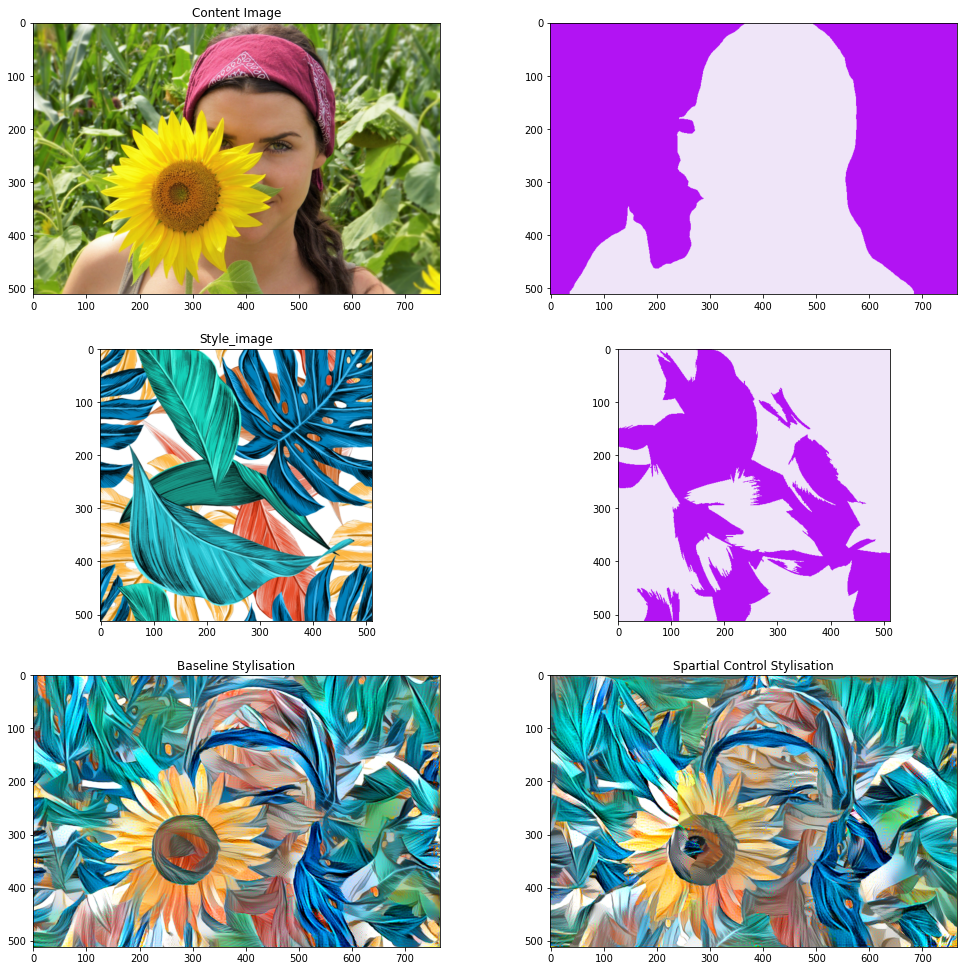

In [66]:
display_results_v1("1.jpg", "1.jpg")

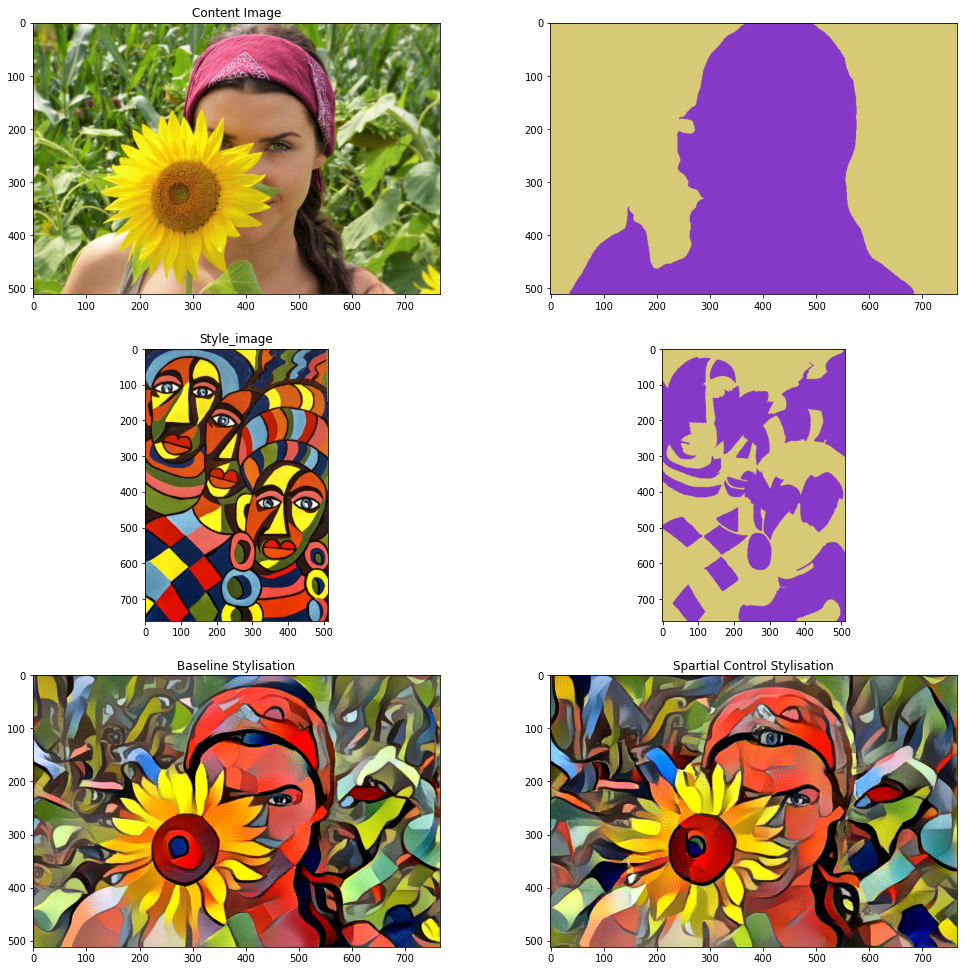

In [67]:
display_results_v1("2.jpg", "1.jpg")

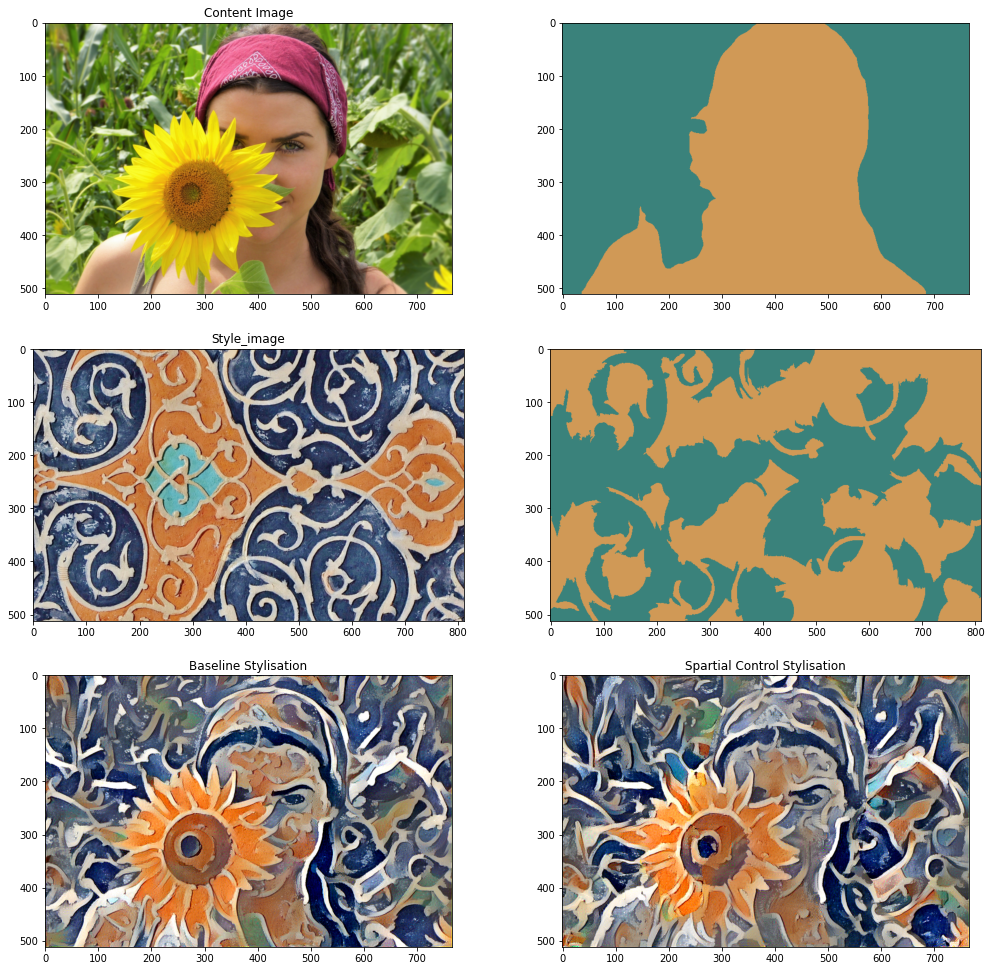

In [68]:
display_results_v1("3.jpg", "1.jpg")

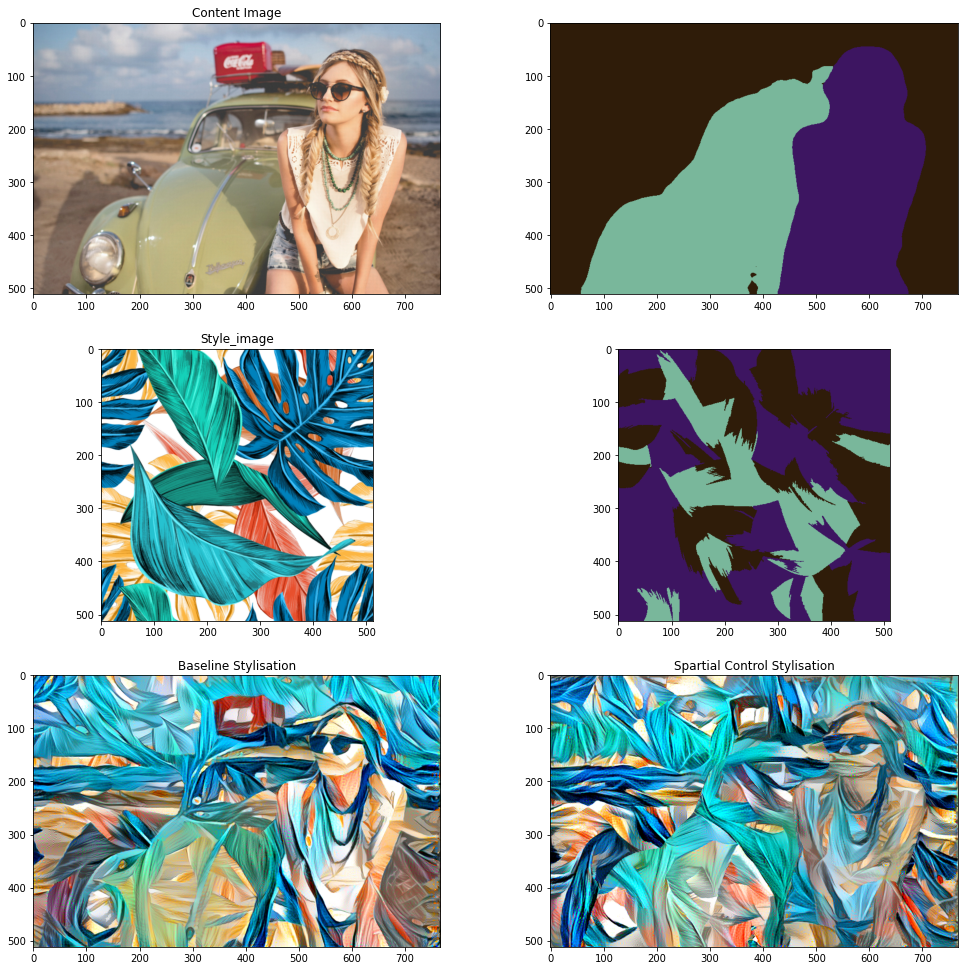

In [70]:
display_results_v1("1.jpg", "2.jpg")

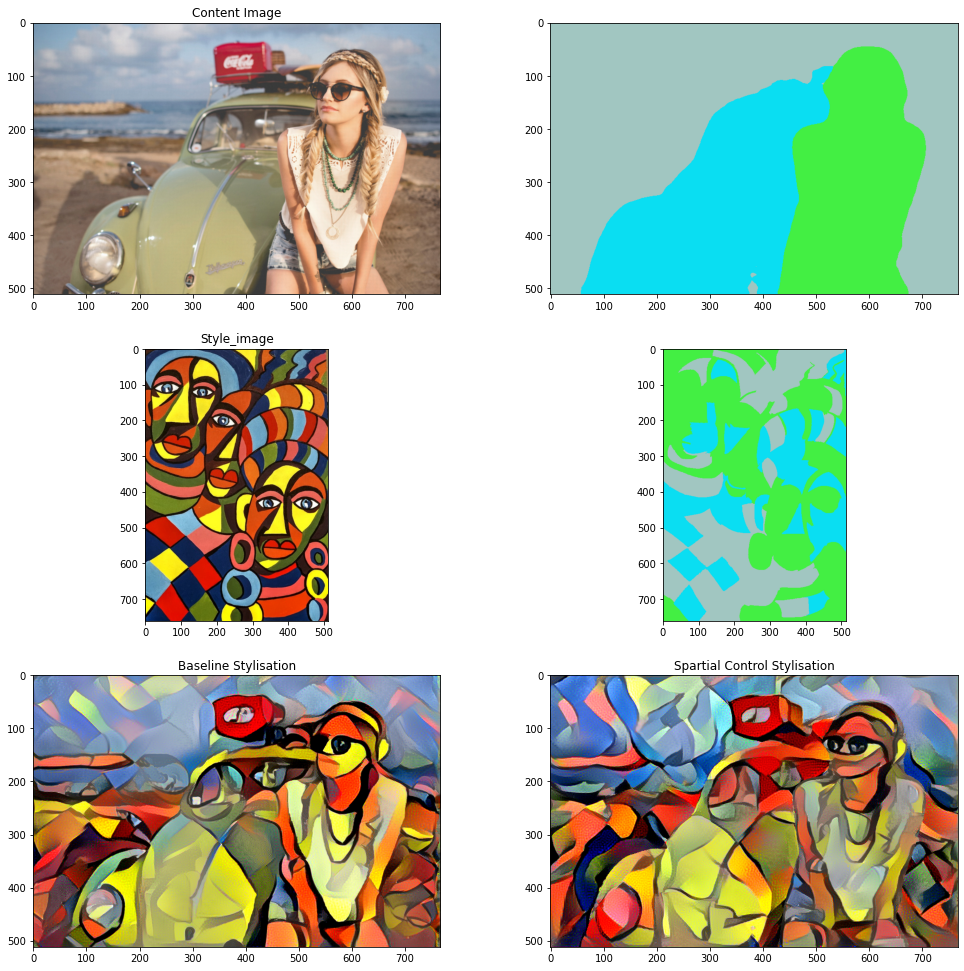

In [71]:
display_results_v1("2.jpg", "2.jpg")

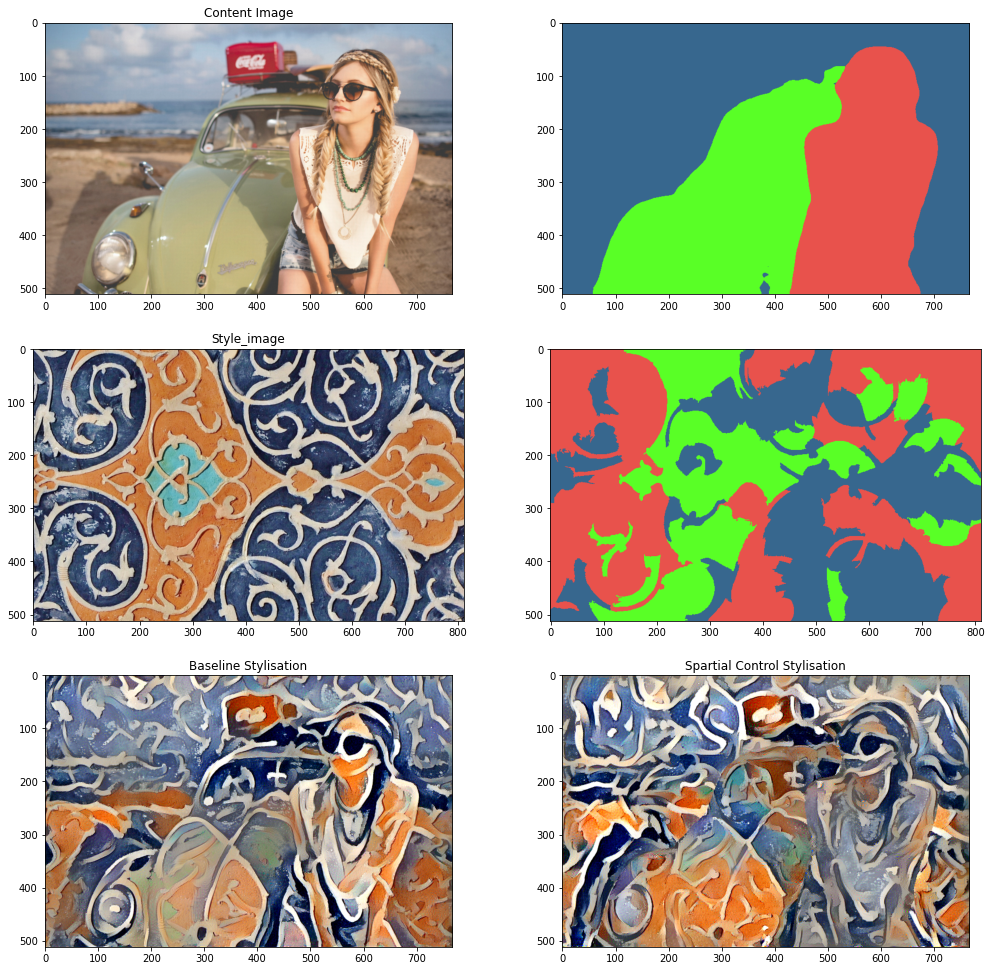

In [72]:
display_results_v1("3.jpg", "2.jpg")

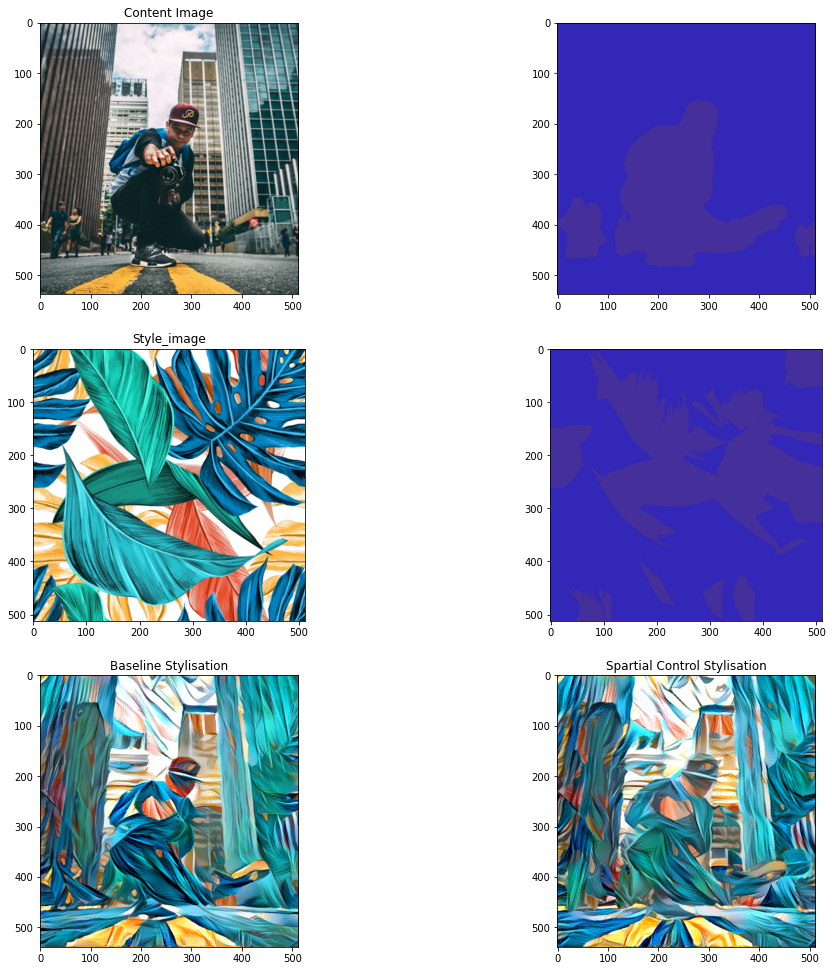

In [73]:
display_results_v1("1.jpg", "3.jpg")

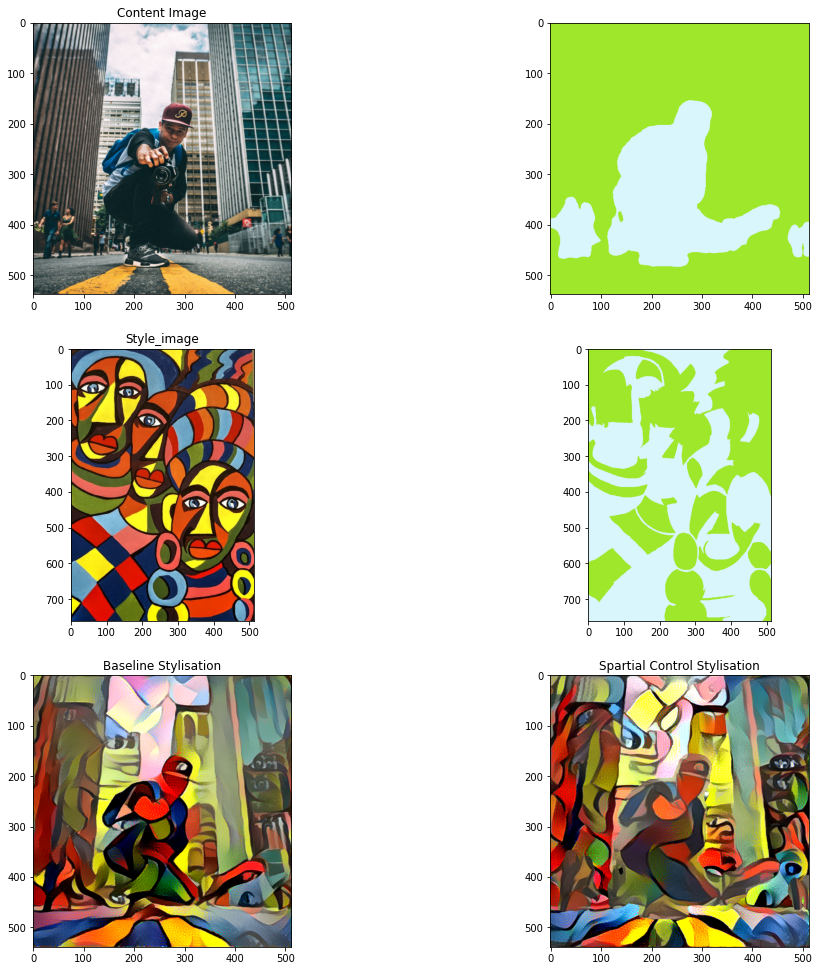

In [74]:
display_results_v1("2.jpg", "3.jpg")

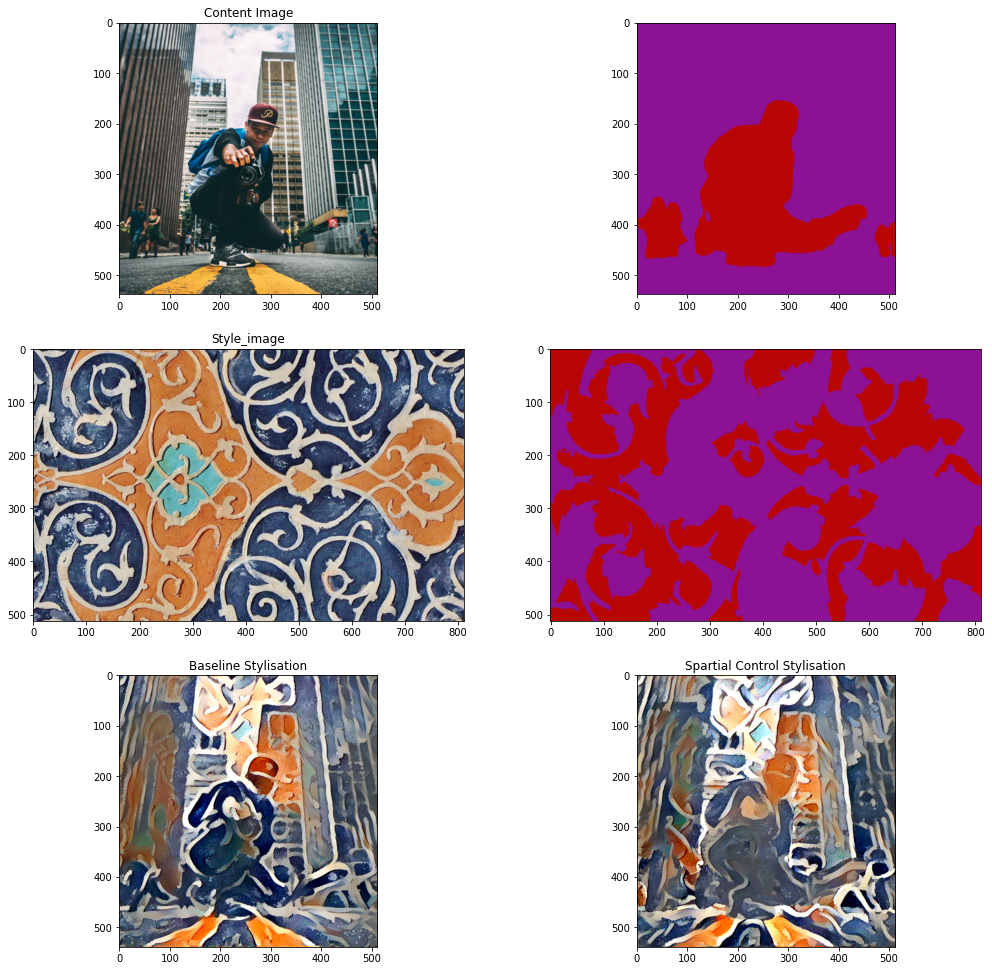

In [75]:
display_results_v1("3.jpg", "3.jpg")

### Display averaging

In [76]:
def display_averaging(style_name, img_name):
    

    
    style_img, content_img = get_imgs(style_name, img_name)
    
    style_prep = prepare_img(style_img)
    content_prep = prepare_img(content_img)
    
    resulting_0, _, _ = style_transfer_method4(style_name, img_name,
                                               debug_flg = False, display_flg = False,
                                               averaging = 0)
    
    resulting_33, _, _ = style_transfer_method4(style_name, img_name,
                                           debug_flg = False, display_flg = False,
                                           averaging = 0.33)
    
    resulting_66, _, _ = style_transfer_method4(style_name, img_name,
                                               debug_flg = False, display_flg = False,
                                               averaging = 0.66)
    
    resulting_100, _, _ = style_transfer_method4(style_name, img_name,
                                               debug_flg = False, display_flg = False,
                                               averaging = 1)
    
    fig, ax = plt.subplots(3, 2, figsize = [17, 17])
    ax[0, 0].imshow(postprocessing(content_prep[0].cpu()))
    ax[0, 0].set_title("Content Image")
    
    ax[0, 1].imshow(postprocessing(style_prep[0].cpu()))
    ax[0, 1].set_title("Style_image")
    
    ax[1, 0].imshow(resulting_0)
    ax[1, 0].set_title("Averaging: 0 stylisation")
    
    ax[1, 1].imshow(resulting_33)
    ax[1, 1].set_title("Averaging: 0.33 stylisation")
    
    ax[2, 0].imshow(resulting_66)
    ax[2, 0].set_title("Averaging: 0.66 stylisation")
    
    ax[2, 1].imshow(resulting_100)
    ax[2, 1].set_title("Averaging: 1.00 stylisation")
    
    plt.show()

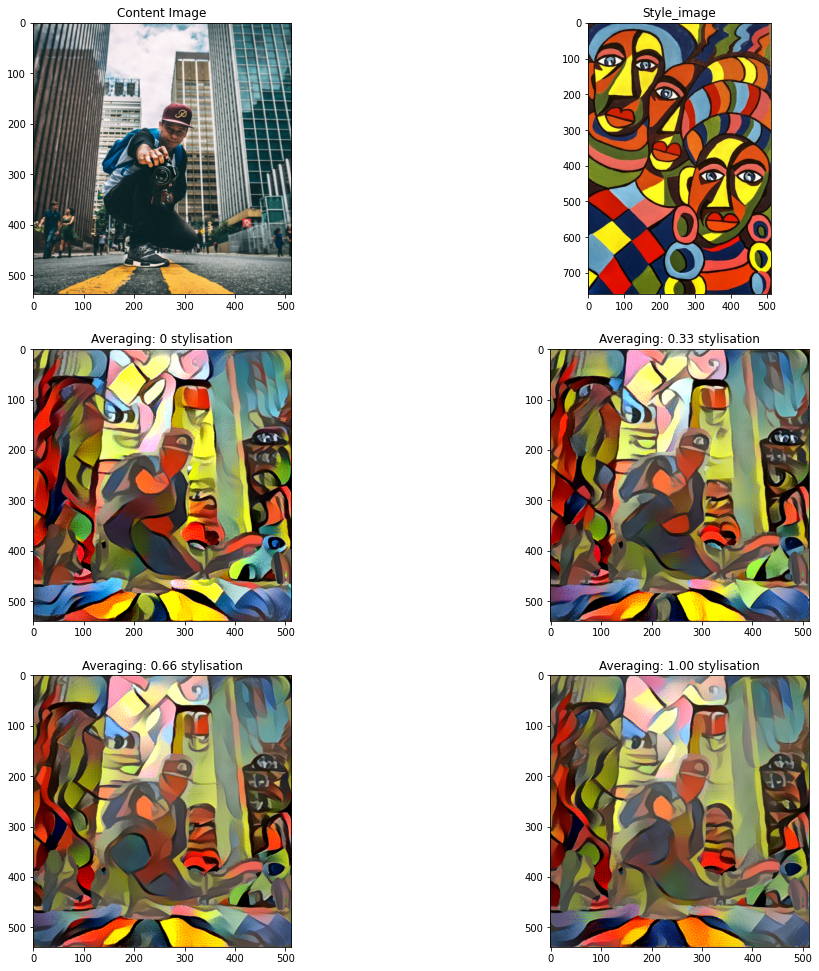

In [77]:
display_averaging("2.jpg", "3.jpg")

# Method 2:

Based upon first version (but this time without averaging), I added relative distance between "patches" of style image as another distance metric:

to "metric distance" used previously I added normalised euclidean distances from already added patches to every other patch from the Style image. Thus providing more centred stylisation masks. 

In [78]:
def display_results_v2(style_name, img_name, guiding_method):
    

    
    style_img, content_img = get_imgs(style_name, img_name)
    
    style_prep = prepare_img(style_img)
    content_prep = prepare_img(content_img)
    
    default_st = style_transfer(style_name, img_name)
    resulting_st, content_masks, style_masks = style_transfer_method4_2(style_name, img_name,
                                                                     debug_flg = False, display_flg = False,
                                                                     averaging = 0, guiding_method = guiding_method,
                                                                     )
    
    fig, ax = plt.subplots(3, 2, figsize = [17, 17])
    ax[0, 0].imshow(postprocessing(content_prep[0].cpu()))
    ax[0, 0].set_title("Content Image")
    
    ax[1, 0].imshow(postprocessing(style_prep[0].cpu()))
    ax[1, 0].set_title("Style_image")
    
    ax[2, 0].imshow(default_st)
    ax[2, 0].set_title("Baseline Stylisation")
    
    ax[2, 1].imshow(resulting_st)
    ax[2, 1].set_title("Spartial Control Stylisation")
    
    content_base = torch.zeros_like(content_prep[0]).cpu()
    style_base = torch.zeros_like(style_prep[0]).cpu()
    
    color_r = []
    color_g = []
    color_b = []
    
    for cnt, stl in zip(content_masks, style_masks):
        
        color = np.random.choice(range(256), size = 3).tolist()
        color_r.append(color[0])
        color_g.append(color[1])
        color_b.append(color[2])
        
        color = torch.Tensor(color)
        
        content_base += color[:, None, None] * cnt.cpu()
        style_base += color[:, None, None] * stl.cpu()
        
    it = transforms.ToPILImage()
    
    ax[0, 1].imshow(it(content_base))
    
    ax[1, 1].imshow(it(style_base))
    plt.show()

In [79]:
def get_guides_v2(content_prep, content_mask, style_prep, style_mask, averaging = 0.0):
    
    if False:
        print(content_prep.shape)
        print(content_mask.shape)
        print(style_prep.shape)
        print(style_mask.shape)
    
    content_guides = []
    content_avgs = []
    content_stds = []
    
    for val in content_mask.unique():
        cg = (content_mask == val)
        
        if torch.sum(cg) < 1e+4:
            content_guides[0] += cg
            continue
        
        content_guides.append(cg.to(torch.float))
        
        mn = []
        st = []
        for i in range(3):
            mn.append(torch.mean(content_prep[i, :, :][cg[:, :]]))
            st.append(torch.std(content_prep[i, :, :][cg[:, :]]))
            
        content_avgs.append(mn)
        content_stds.append(st)
        
    content_guides = content_guides[::-1]
    content_avgs = content_avgs[::-1]
    content_stds = content_stds[::-1]

    style_avgs = []
    style_stds = []
    style_locations = []
    style_masks = []
    
    style_vals = []
    
    for val in style_mask.unique():
        
        style_vals.append(val)
        
        sg = (style_mask == val)
        style_masks.append(sg.to(torch.float))
        
        mn = []
        st = []
        for i in range(3):
            mn.append(torch.mean(style_prep[i, :, :][sg[:, :]]))
            st.append(torch.std(style_prep[i, :, :][sg[:, :]]))
            
        style_avgs.append(mn)
        style_stds.append(st)
        
        dotx, doty = torch.where(style_mask == val)
        dotx = dotx.to(torch.float)
        doty = doty.to(torch.float)
        
        style_locations.append([torch.mean(dotx), torch.mean(doty)])

    style_locs = torch.Tensor(style_locations)
    content_avgs = torch.Tensor(content_avgs)
    content_stds = torch.Tensor(content_stds)
    style_avgs = torch.Tensor(style_avgs)
    style_stds = torch.Tensor(style_stds)
    style_vals = torch.Tensor(style_vals)

    n_patches = len(style_locs) / len(content_avgs)

    locs_distances = torch.cdist(style_locs[None, :, :], style_locs[None, :, :])[0]
    color_means = torch.cdist(content_avgs[None, :, :], style_avgs[None, :, :])[0]
    color_stds = torch.cdist(content_stds[None, :, :], style_stds[None, :, :])[0]

    color_means /= color_means.sum(dim = 1)[:, None]
    color_stds /= color_stds.sum(dim = 1)[:, None]
    locs_distances /= locs_distances.sum(dim = 1)[:, None]
    
    """
    Идея: матчим первый по сумме means и stds.
    Остальные - по means + stds + позиционка относительно уже выбранных
    """
    color_avgs = color_means + color_stds
    
    only_avgs = True
    
    used_patches = set()
    
    def generate_next(color_pt, used_gd):
        
        if used_gd.__len__():
            
            dists = locs_distances[used_gd[0]].clone()
            
            for gd in used_gd[1:]:
                
                dists += locs_distances[gd]
                
            dists /= float(len(used_gd))
            
        created_dists = color_pt * 5 + dists
        
        pr_ty =  torch.argsort(created_dists)
        
        for obj in pr_ty:
            
            if int(obj) not in used_patches and int(obj) not in used_gd:
                used_gd.append(int(obj))
                used_patches.add(int(obj))
                return

    
    K = [0] * len(color_avgs)

    used_guides = []

    for i in range(len(color_avgs)):
        used_guides.append([])
        
    priority = torch.argsort(color_avgs, dim = 1)
    
    for i in range(used_guides.__len__()):
        
        while int(priority[i][K[i]]) in used_patches:
            K[i] += 1
            
        used_patches.add(int(priority[i][K[i]]))
        used_guides[i].append(int(priority[i][K[i]]))
        
    while len(used_patches) < len(locs_distances):

        for j in range(used_guides.__len__()):
            
            color_dist = color_avgs[j]
            generate_next(color_dist, used_guides[j])
            
    style_guides = []

    for patches in used_guides:

        sub = style_masks[patches[0]].clone()

        for pos in patches[1:]:

            sub += style_masks[pos]

        style_guides.append(sub)

    return content_guides, style_guides

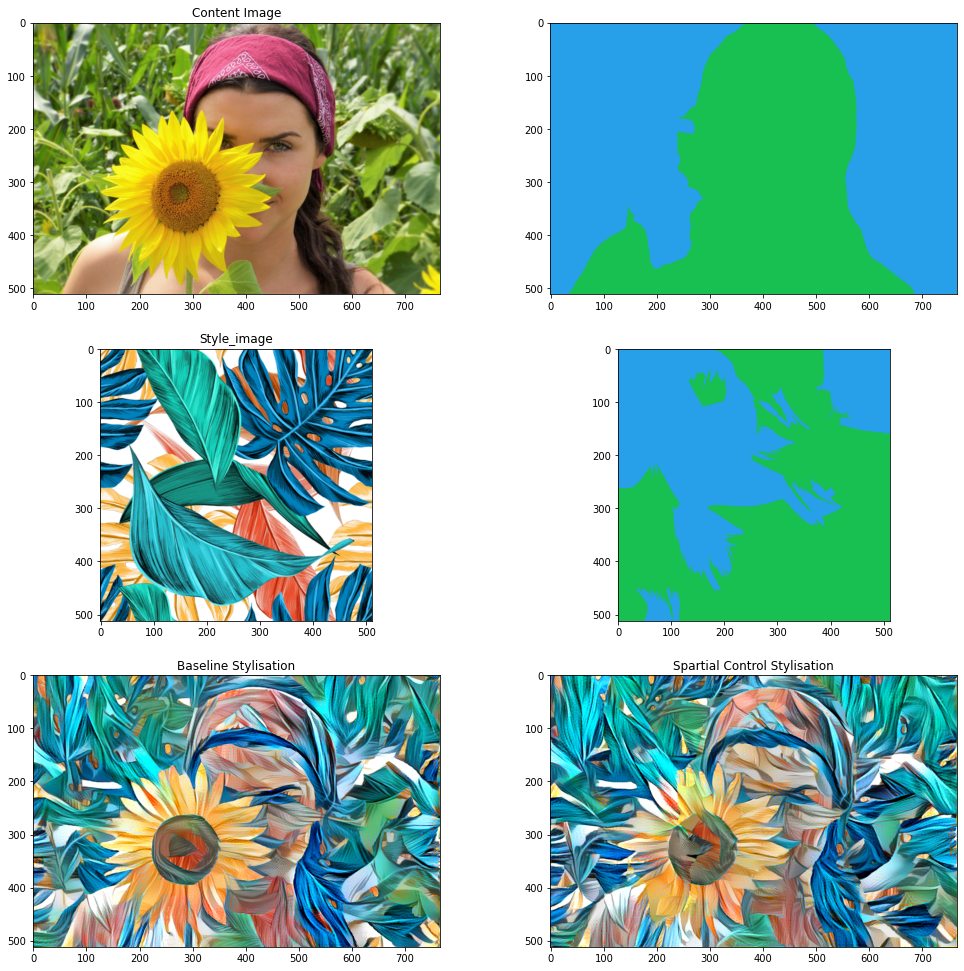

In [80]:
display_results_v2("1.jpg", "1.jpg", get_guides_v2)

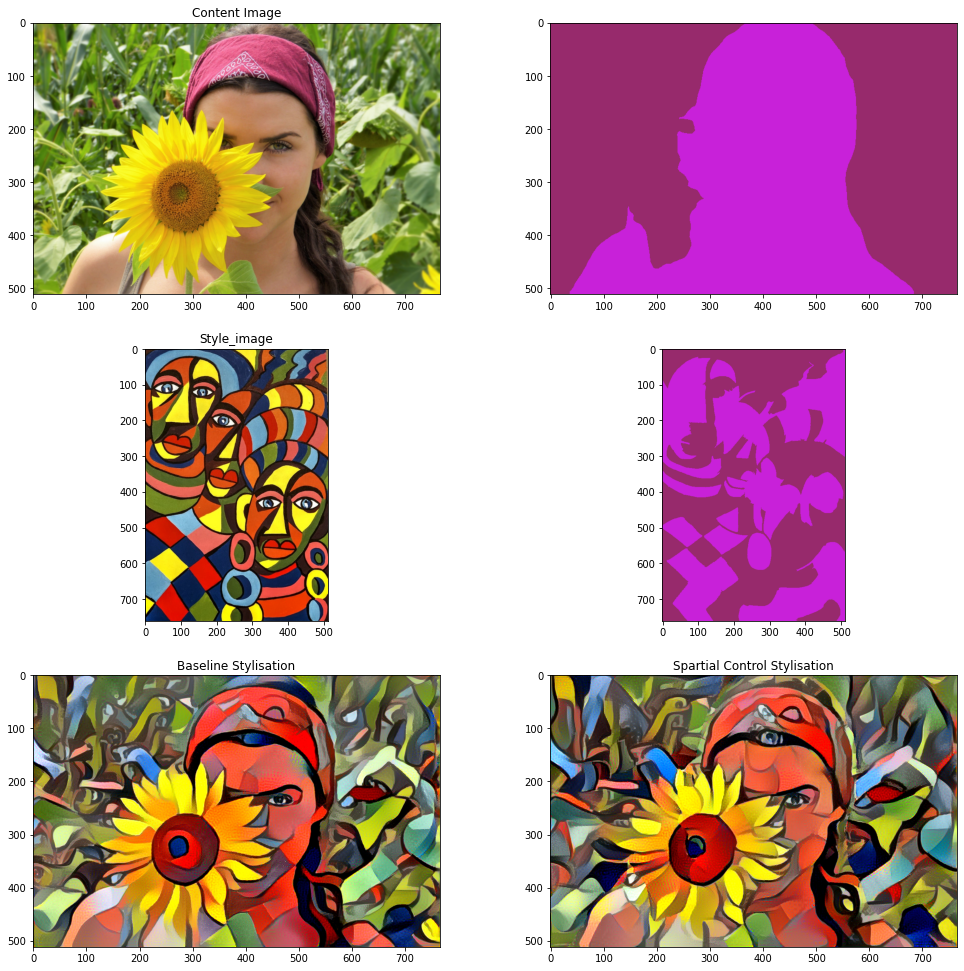

In [81]:
display_results_v2("2.jpg", "1.jpg", get_guides_v2)

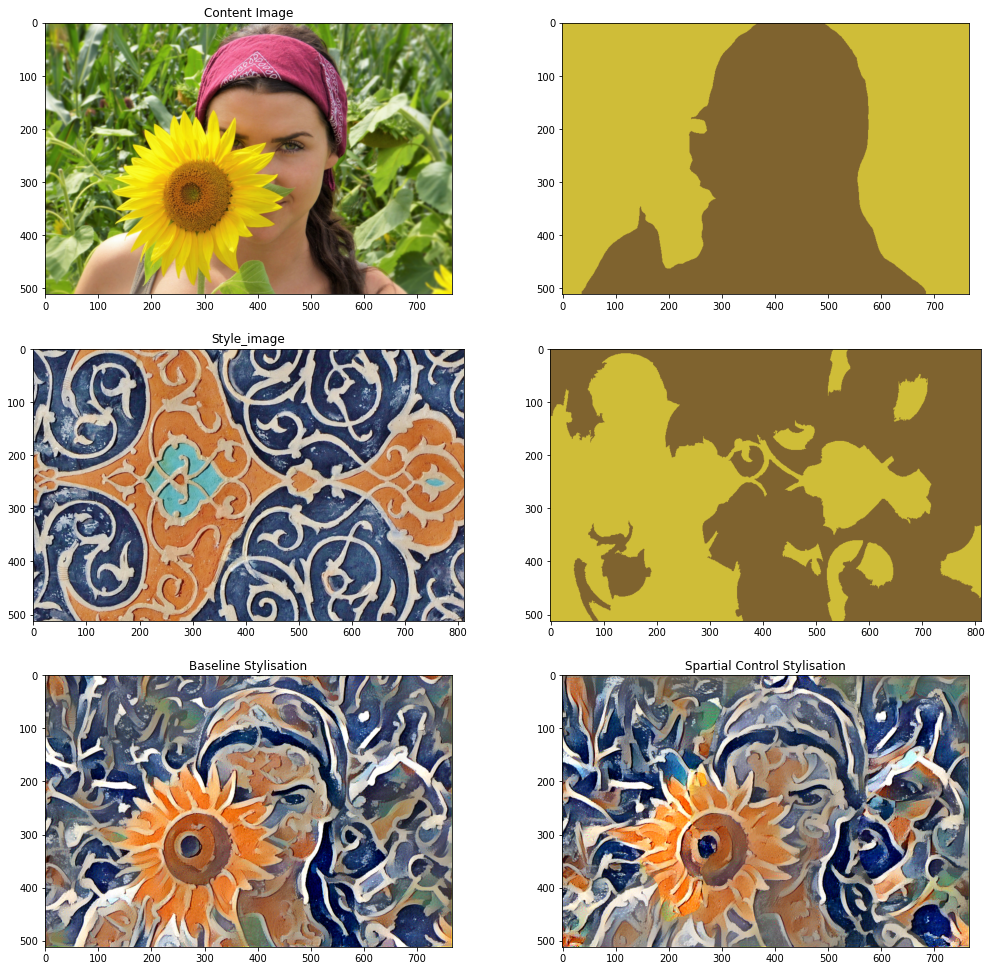

In [82]:
display_results_v2("3.jpg", "1.jpg", get_guides_v2)

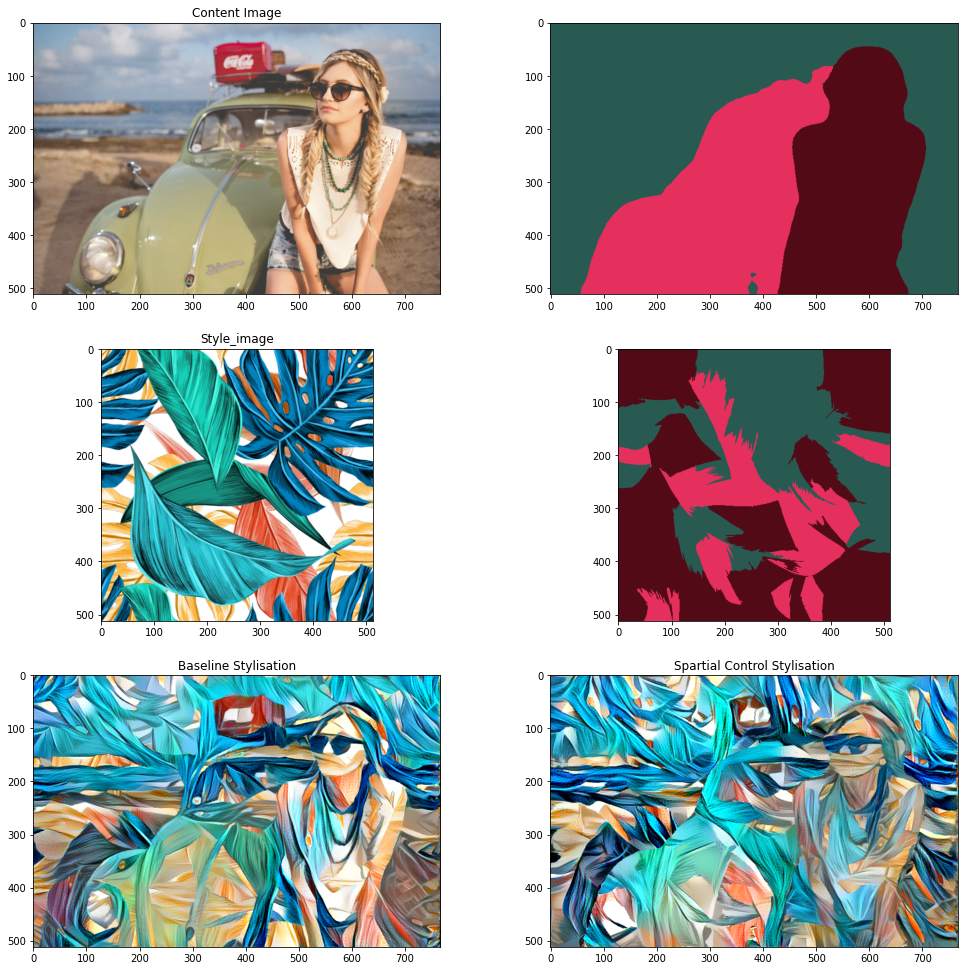

In [83]:
display_results_v2("1.jpg", "2.jpg", get_guides_v2)

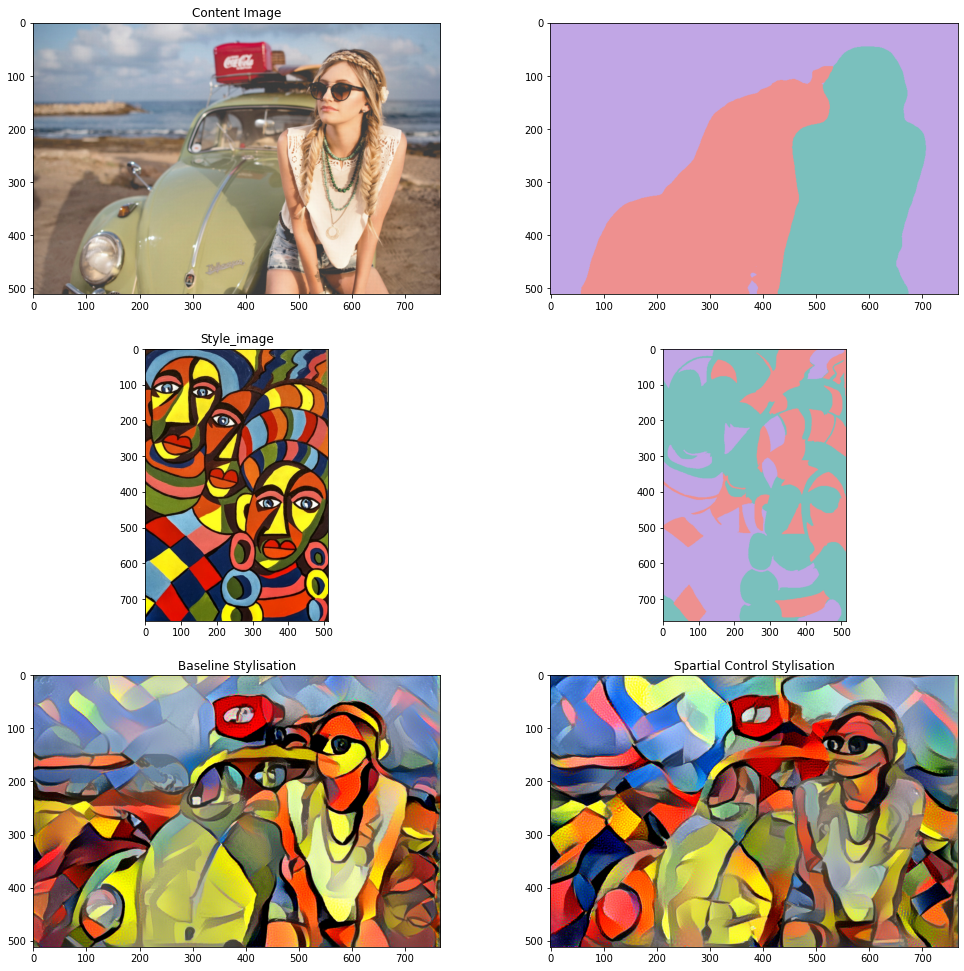

In [84]:
display_results_v2("2.jpg", "2.jpg", get_guides_v2)

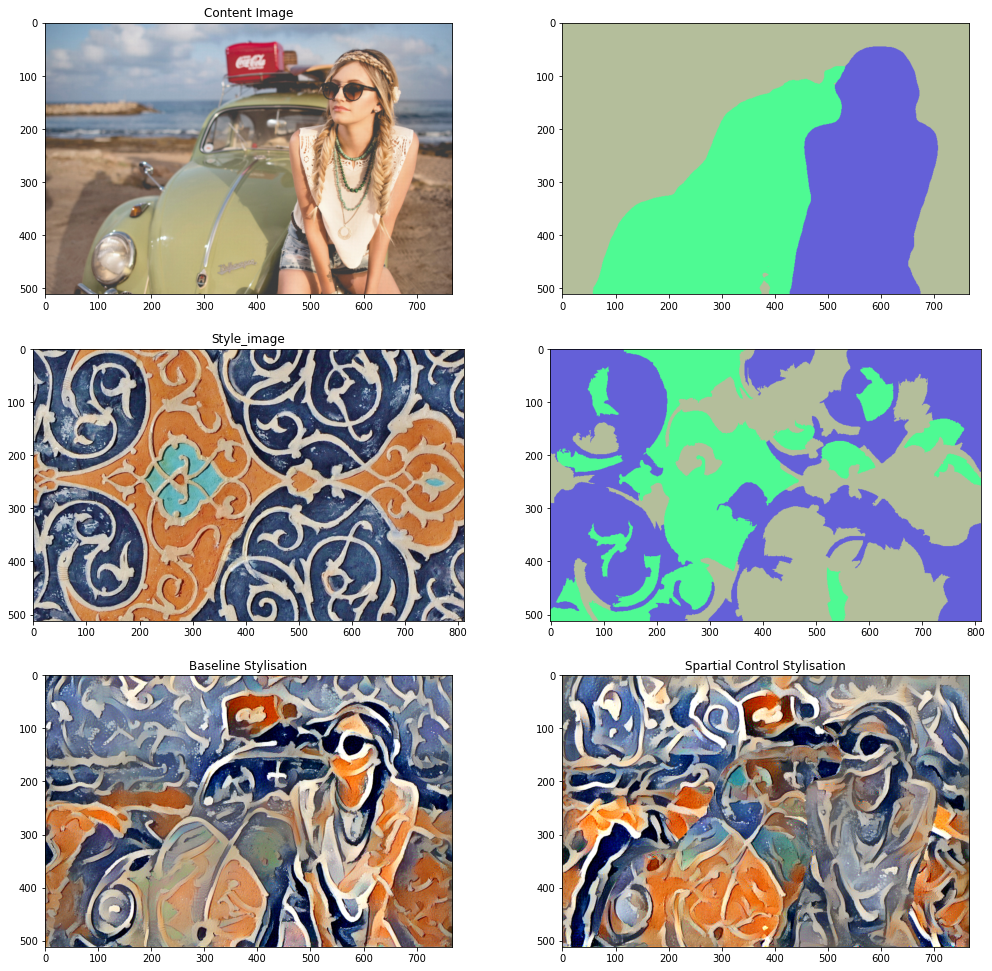

In [85]:
display_results_v2("3.jpg", "2.jpg", get_guides_v2)

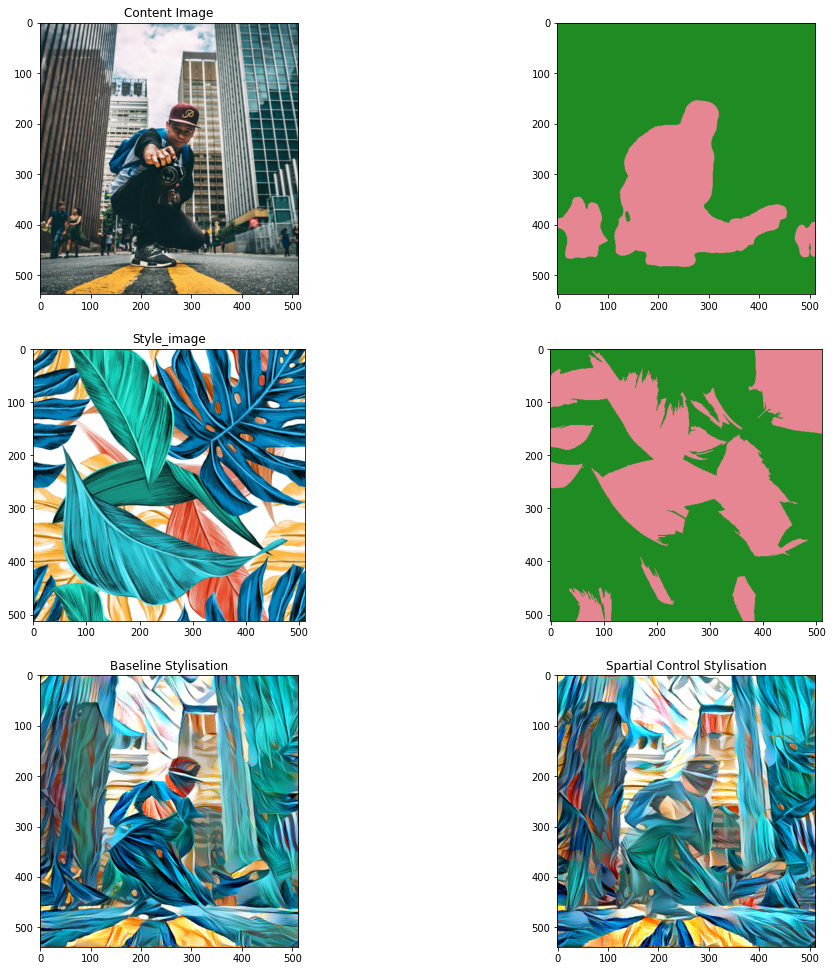

In [86]:
display_results_v2("1.jpg", "3.jpg", get_guides_v2)

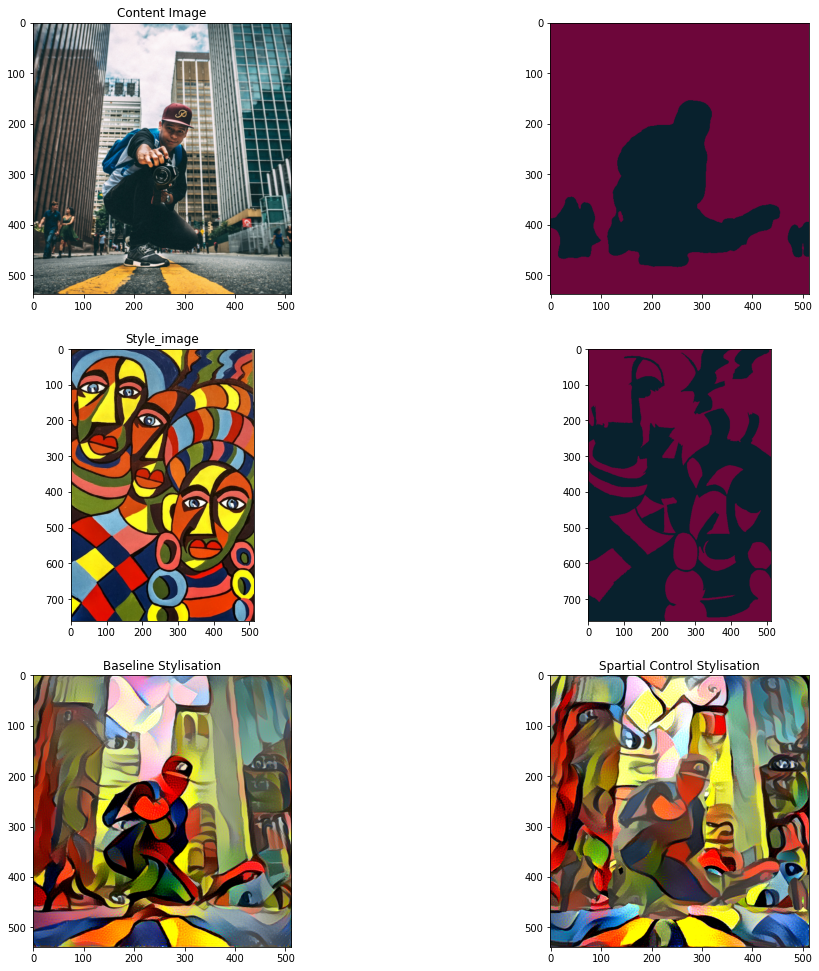

In [87]:
display_results_v2("2.jpg", "3.jpg", get_guides_v2)

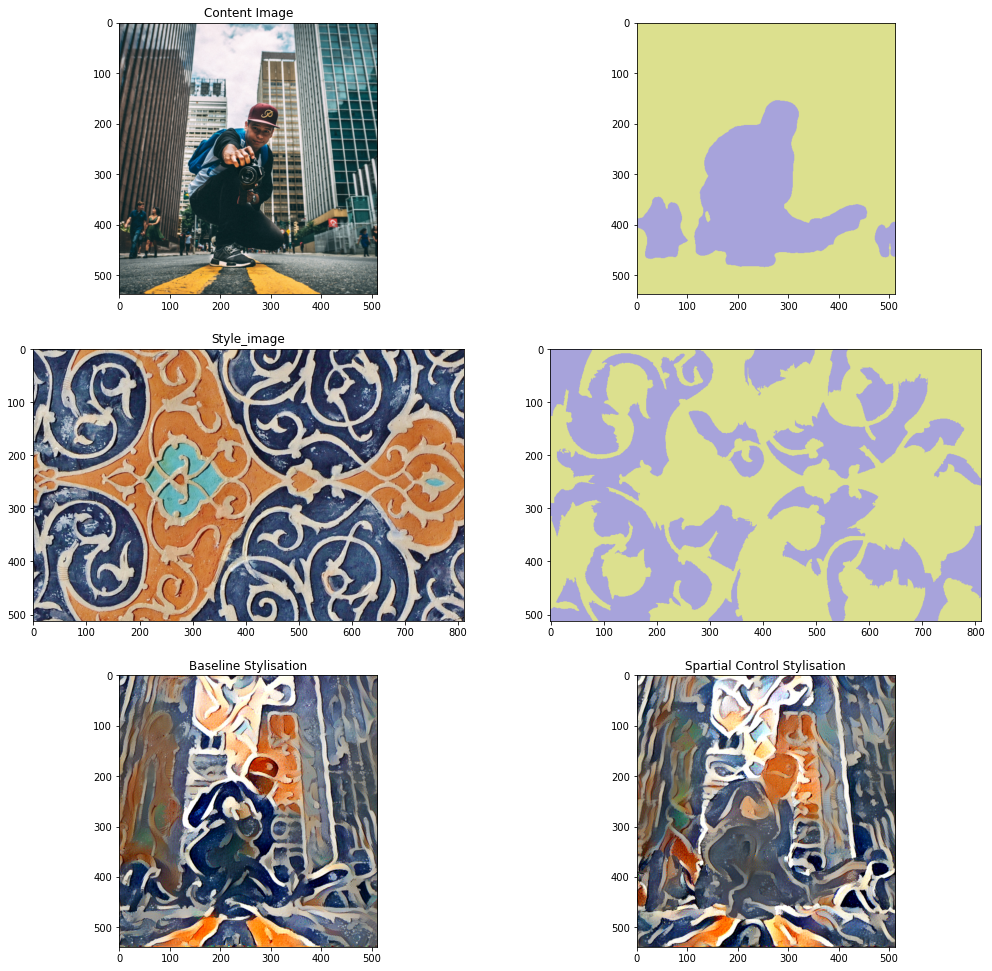

In [88]:
display_results_v2("3.jpg", "3.jpg", get_guides_v2)





